<a href="https://colab.research.google.com/github/JonabelBaldres/AppPhysics155-2022/blob/main/%5B5%5D_Module_5_Partial_Differential_Equations.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **AP155 Lab Assignment** 
## Module 6: Partial Differential Equations

_Instructions_: Answer each problem as completely as you can. Discuss **all** your answers as clearly and concisely as possible. 

_Scoring Criteria_: 50% - *correctness of code*; 50% - *discussion of the code and results*. Maximum score is **100 points** (Problems 1 and 2 are worth 50 points each).

_Due Date_: **5PM of December 21 (Tue)**


### Student Information 

_Full Name (Last Name, First Name)_: Jonabel Eleanor Baldres \
_Student No._: 2020-07278\
_Section_: THU-HX-3

### Submission Information

_Date and Time Submitted (most recent upload)_: December 15, 2022

**HONOR PLEDGE** I affirm that I have upheld the highest principles of honesty and integrity in my academic work and that this lab assignment is my own work.

**Sign here with your full name:** sgd. Jonabel Eleanor Baldres

### Grading Information (c/o Lab Instructor)

TOTAL SCORE: **[]**/100

Score breakdown:
* Problem 1 - []/50
* Problem 2 - []/50

_Date and Time Scored (MM/DD/YYYY HH:MM AM/PM):_ 

In [ ]:
#importing all necessary functions
import numpy as np
from numpy import copy, empty
from math import exp
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import Image

### PROBLEM 1 (50 pts.; 50/50 for code & discussion) 
**The Schrodinger equation and the Crank-Nicolson method**

_Refer to Exercise 9.8 in the Newman text._ In this problem, you will use the Crank-Nicolson method to solve the full time-dependent Schrodinger equation and hence develop a picture of how a wavefunction evolves over time.

Consider an electron (mass $M = 9.109 \times 10^{-31}$ kg) in a box of length $L = 10^{-8}$ m. Suppose that at time $t = 0$ the wavefunction of the electron has the form

$$ \psi(x,0) = \exp\left[-\frac{(x-x_0)^2}{2\sigma^2}\right]e^{i\kappa x},$$
where $x_0 = \frac{L}{2}$, $\sigma = 1 \times 10^{-10}$ m, $\kappa = 5 \times 10^{10} {\rm m}^{-1}$,  and $\psi = 0$ on the walls at $x = 0$ and $x = L$.

1. Perform a single step of the Crank-Nicolson method for this electron, calculating the vector $\psi(t)$ of values of the wavefunction, given the initial wavefunction above and using $N = 1000$ spatial slices with $a = L/N$. Your program will have to perform the following steps. First, given the vector $\psi(0)$ at $t = 0$, you will have to multiply by the matrix $\bf{B}$ to get a vector $\bf{v} = \bf{B}\psi$. Because of the tridiagonal form of $\bf{B}$, this is fairly simple. The $i$th component of $\bf{v}$ is given by
$$ v_i = b_1\psi_i + b_2(\psi_{i+1} + \psi_{i-1}).$$

   You will also have to choose a value for the time-step $h$. A reasonable choice is $h = 10^{-18}$ s. *(15 pts.)*

2. Second you will have to solve the linear system ${\bf Ax}= {\bf v}$ for $\bf{x}$, which gives you the new value of $\psi$. You could do this using a standard linear equation solver like the function $\tt solve$ in numpy's $\tt linalg$. *(10 pts.)*

3. Once you have the code in place to perform a single step of the calculation, extend your program to perform repeated steps and hence solve for $\psi$ at a sequence of times a separation $h$ apart. Note that the matrix $\bf A$ is independent of time, so it doesn't change from one step to another. You can set up the matrix just once and then keep on reusing it for every step. *(15 pts.)*

4. Make an animation of the solution by displaying the real part of the wavefunction at each time-step. You can use the function rate from the package visual to ensure a smooth frame-rate for your animation-- see Section 3.5 on page 117 of the Newman text. 

   Run your animation for a while and describe what you see. Write a few sentences explaining in physics terms what is going on in the system. *(10 pts.)*

The Crank-Nicolson method is an average of the combination of the two methods: Implicit method and FTCS. The equation can be written in the form

\begin{align}
  \mathbf{A} \psi (t+h) = \mathbf{B} \psi (t) 
  \end{align}

where $\textbf{A}$ and $\textbf{B}$ are matrices that are both symmetrical and tridiagonal. 

In this problem, the tridiagonal entries are as follows

\begin{align}
  a_1 &= 1 + h \frac{i \hbar}{2ma^2} \\
  a_2 &= -h \frac{i \hbar}{4ma^2} \\ 
  b_1 &= 1 - h \frac{i \hbar}{2ma^2} \\
  b_2 &= h \frac{i \hbar}{4ma^2}
  \end{align}

The above equations are defined via the codes below.

In [ ]:
#listing the constants and parameters
M = 9.109e-31         #mass of electron, kg
L = 1.e-8             #length of the box, m
x0 = L/2              #initial x at t=0
sigma = 1.e-10        #width of the wave packet
kappa = 5.e10         #wave number
x_1 = 0               #boundary condition
x_2 = L               #boundary condition
h = 1.e-18            # size of the time step
hbar = 1.05457182e-34 #planck's constant
N = 1000              #spatial slices
a = L/N               #spacing of spatial grids

In [ ]:
# defining matrix entries for A and B
a_1 = 1+ (h*1j*hbar)/(2*M*a**2)
a_2 = - h*1j*hbar/(4*M*a**2)
b_1 = 1 - (h * ((1j * hbar) / (2*M*(a**2))))
b_2 = h * ((1j * hbar) / (4*M*(a**2)))

In [ ]:
def psi(x):
  '''defining the initial wave function'''
  return np.exp(-((x-x0) ** 2)/(2 * sigma**2)) *  np.exp(1j*kappa*x)

In [ ]:
A = np.zeros([3,N+1], complex)  # 3 rows, 1001 columns
A[0,:] = a_2 #all the elements of the first zero array is equal to a_2
A[1,:] = a_1 #all the elements of the second zero array is equal to a_1
A[2,:] = a_2 #all the elements of the third zero array is equal to a_2

In [ ]:
X = np.linspace(0, L, N+1) #value for x
psi0 = np.zeros((N+1), complex) #array for storing values of psi
for i, j in enumerate(X):
  psi0[i] = psi(j)

The figure below shows the wave function when t = 0.

/usr/local/lib/python3.8/dist-packages/matplotlib/cbook/__init__.py:1317: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


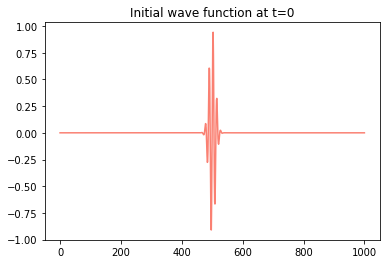

In [ ]:
plt.plot(psi0, color = 'salmon')
plt.title("Initial wave function at t=0")
plt.show()

In [ ]:
def banded(Aa,va,up,down): #3 by n matrix, b_solving, 1, 1

    # Copy the inputs and determine the size of the system
    A = copy(Aa)
    v = copy(va)
    N = len(v)

    # Gaussian elimination
    for m in range(N):

        # Normalization factor
        div = A[up,m]

        # Update the vector first
        v[m] /= div
        for k in range(1,down+1):
            if m+k<N:
                v[m+k] -= A[up+k,m]*v[m]

        # Now normalize the pivot row of A and subtract from lower ones
        for i in range(up):
            j = m + up - i
            if j<N:
                A[i,j] /= div
                for k in range(1,down+1):
                    A[i+k,j] -= A[up+k,m]*A[i,j]

    # Backsubstitution
    for m in range(N-2,-1,-1):
        for i in range(up):
            j = m + up - i
            if j<N:
                v[m] -= A[i,j]*v[j]

    return v

The Crank-Nicolson equation has precisely the form 

\begin{align}
  \mathbf{Ax} = \mathbf{v}
  \end{align}

Since $\textbf{B}$ is in triadiagonal form, we can obtain the $ith$ component of $\textbf{v}$ through the equation

\begin{align}
  v_i = b_1 \psi_i + b_2 (\psi_{i+1} + \psi_{i-1})
  \end{align}


In [ ]:
#defining vector v
v_grid = np.zeros(N+1, complex)
v_grid[1:N] = b_1 * psi0[1:N] + b_2 * (psi0[2:N+1] + psi0[0:N-1])

#solving for the linear system using banded.py
psi = banded(A, v_grid, 1,1)

Checking the wavefunction after 500 steps

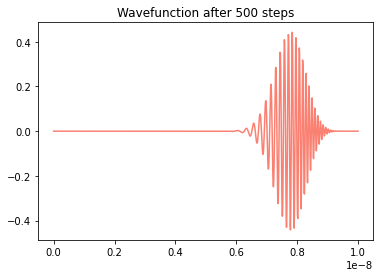

In [ ]:
#For 500 steps 
for i in range(500):
  v_grid[1:N] = b_1 * psi[1:N] + b_2 * (psi[2:N+1] + psi[0:N-1])
  psi = banded(A, v_grid, 1, 1)

#plotting 
plt.plot(X, np.real(psi), color = 'salmon')
plt.title("Wavefunction after 500 steps")
plt.show()

We now animate the real part of the wave function after 10000 steps. 

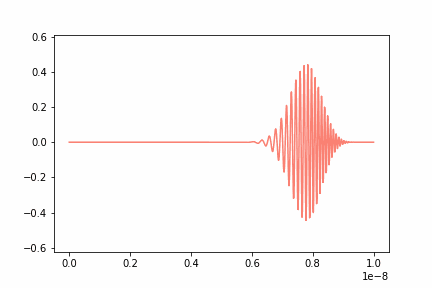

In [ ]:
frames = []
fig = plt.figure()

for i in range(0,10000,1):
  v_grid = np.zeros(N+1, complex)
  v_grid[1:N] = b_1 * psi[1:N] + b_2 * (psi[2:N+1] + psi[0:N-1])
  psi = banded(A, v_grid, 1,1)

  if i%10 == 0:
    frames.append(plt.plot(X, np.real(psi), color = 'salmon'))

ani = animation.ArtistAnimation(fig,frames, interval = 50, blit = True, repeat_delay = 1000)
writergif = animation.PillowWriter(fps = 30)
ani.save('Problem 1 animation.gif', writer=writergif)
plt.close()

Image(filename= "Problem 1 animation.gif")

From the animation above, we can see that the wave packet is constrained inside the walls. Since the walls are impenetratable, the particle only bounces back from one wall to another. And as it bounces back, the wave function changes  indicating the behavior of the particle. As time passes by, the probability of finding the particle in some region in space varies. At the initial time, the probability of finding the particle in one position is significantly higher than the rest but as time goes by, the certainty of the position of the particle decreases, especially when the particle hits the barriers. 

### PROBLEM 2 (50 pts.; 50/50 for code & discussion)

**The Schrodinger equation and the spectral method**

_Refer to Exercise 9.9 in the Newman text._ In this problem, you will use the spectral method to solve the time-dependent Schodinger equation for the same system as in Problem 1, a single particle in one dimension in a box of length $L$ with impenetrable walls. 

To perform the fast transforms needed for this problem, you can use the scipy $\tt fftpack$ package's discrete sine transform $\tt dst$ ([documentation](https://docs.scipy.org/doc/scipy/reference/generated/scipy.fftpack.dst.html)) and inverse discrete sine transform $\tt idst$ ([documentation](https://docs.scipy.org/doc/scipy/reference/generated/scipy.fftpack.idst.html)). Alternatively, you can use the corresponding functions in the $\tt dcst$ package in Appendix E of the Newman text. 

1. Calculate the values of the coefficients $b_k$ which for convenience can be broken down into their real and imaginary parts as $b_k = \alpha_k + i \eta_k$· Divide the box into $N = 1000$ slices and create two arrays containing the real and imaginary parts of $\psi(x_n,0)$ at each grid point. Perform discrete sine transforms on each array separately and hence calculate the values of the $\alpha_k$ and $\eta_k$ for all $k=1$...$N-1$. *(15 pts.)*

2. Putting $b_k = \alpha_k +i \eta_k$ in the solution above and taking the real part we get $ {\rm Re}\ \psi(x_n, t) $ equals
$$\frac{1}{N} \sum_{k=1}^{N-1} \left[\alpha_k \cos\left(\frac{\pi^2\hbar k^2}{2ML^2}t\right) - \eta_k \sin\left(\frac{\pi^2\hbar k^2}{2ML^2}t\right)\right]\sin\left(\frac{\pi kn}{N}\right)$$
for the real part of the wavefunction. This is an inverse sine transform with coefficients equal to the quantities in the square brackets. 

   Calculate the real part of the wavefunction $\psi(x,t)$ at an arbitrary time $t$ using this formula and the inverse discrete sine transform function. *(10 pts.)* 
   
3. Test your program by making a graph of the wavefunction at time $t = 10^{-16}$ s. *(10 pts.)*

4. Make an animation of the wavefunction over time, similar to that described in part (4) of Problem 1 above. A suitable time interval for each frame of the animation is about $10^{-18}$ s. Run your animation for a while and describe what you see. Write a few sentences explaining in physics terms what is going on in the system. *(15 pts.)*


Using the spectral method to solve the time-dependent Schrodinger equation for the same system as the problem above, we first note that we are given the wavefunction

\begin{align}
  \psi_{k}(x,t)  = \sin{\left( \frac{\pi k x}{L}\right) e^{iEt/\hbar}}
  \end{align}

where the energy E can be found by the equation

\begin{align}
  \frac{\pi^2 \hbar^2 k^2 }{2ML^2}
  \end{align}

The whole solution can be written as a linear combination of individual solutions which on the grid points takes the value

\begin{align}
  \psi(x_n,t) = \frac{1}{N} \sum^{N-1}_{k=1} b_k \sin{{\left( \frac{\pi k n}{L}\right)}} \text{exp} \left( \frac{i \pi^2 \hbar k^2}{2ML^2} \right)
  \end{align}

In [ ]:
#defining discrete sine transform and inverse discrete since transform from Newmann's book.
#with few modifications
#1D DST Type-I
from numpy .fft import rfft , irfft
def dst(y):
    N = len(y)
    y2 = empty(2*N,float)
    y2[0] = y2[N] = 0.0
    y2[1:N] = y[1:]
    y2[:N:-1] = -y[1:]
    a = -np.imag(rfft(y2))[:N]
    a[0] = 0.0

    return a


def idst(a):
    N = len(a)
    c = empty(N+1,complex)
    c[0] = c[N] = 0.0
    c[1:N] = -1j*a[1:]
    y = irfft(c)[:N]
    y[0] = 0.0

    return y

The coefficient $b_k$ can be broken down into real and imaginary parts: $b_k = \alpha_k + i\eta_k$. Here, we are tasked to divide the box into $N = 1000$ slices and create two arrays for the real and imaginary part of $psi(x_n,0)$. Through discrete fourier transform, we can get the values for $\alpha_k$ and $\eta_k$.

In [ ]:
def psi(x):
  '''returns the real and imaginary part of psi'''
  real = np.exp(-((x-x0) ** 2)/(2 * sigma**2)) *  np.cos(kappa*x)
  imag = np.exp(-((x-x0) ** 2)/(2 * sigma**2)) *  np.sin(kappa*x)
  return real, imag

#real and imaginary arrays which will be used to store the real and imaginary part of the function
real_part = empty(N+1, float)
imag_part = empty(N+1, float)

#filling arrays with real or imag values
for i in range(0,N+1):
  real_part[i], imag_part[i] = psi(i*a) 

#calculating  discrete sine transform on each array of psi
alpha = dst(real_part)
eta = dst(imag_part)


We now use the value obtained above to get the solution for the real part of the wavefunction via the equation:

\begin{align}
\text{Re} \psi (x_n, t) = \frac{1}{N} \sum^{N-1}_{k=1} \left[   \alpha_k \cos{{\left( \frac{\pi^2 k^2 \hbar}{2ML^2}t \right)}} - \eta_k \sin{{\left( \frac{\pi^2 k^2 \hbar}{2ML^2} t \right)}} \right] \sin{\left( \frac{\pi k n}{N} \right)}
  \end{align}


In [ ]:
def realpsi(t):
  '''returns the real part of psi'''
  real_part = empty(N+1, complex)
  for i in range(0, N+1):
    real_part[i] = alpha[i]*np.cos(((np.pi**2*hbar*i**2)/(2*M*L**2))*t) - eta[i]*np.sin(((np.pi**2*hbar*i**2)/(2*M*L**2))*t)
  inversed = idst(real_part) #inverse discrete sine transform to get the real part of psi
  return inversed

Plotting the function in terms of varied time.

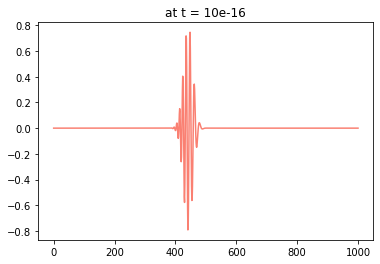

In [ ]:
plt.plot(realpsi(10**(-16)), color = 'salmon')
plt.title("at t = 10e-16")
plt.show()

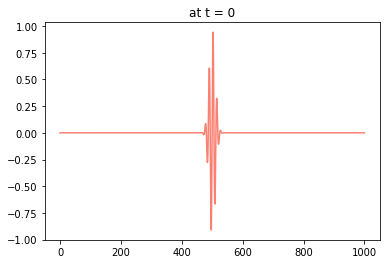

In [ ]:
plt.plot(realpsi(0), color = 'salmon')
plt.title("at t = 0")
plt.show()

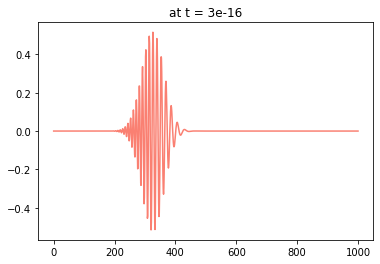

In [ ]:
plt.plot(realpsi(3e-16), color = 'salmon')
plt.title("at t = 3e-16")
plt.show()

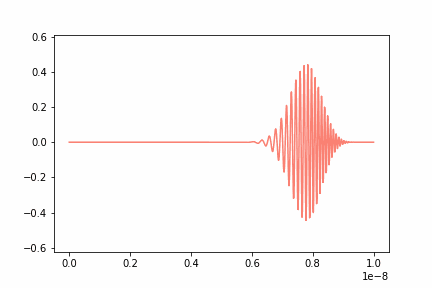

In [ ]:
#Making an animation with time interval 10^-18 s. 
frames1 = []
fig1 = plt.figure()

t_values = np.arange(0,5000e-18,1e-18)
for t in range(len(t_values)):
  if t%10 == 0:
    frames1.append(plt.plot(realpsi(t_values[t]) , color = 'salmon'))

ani1 = animation.ArtistAnimation(fig1,frames1, interval = 50, blit = True, repeat_delay = 1000)
writergif1 = animation.PillowWriter(fps = 30)
ani.save('Problem 2 animation.gif', writer=writergif)
plt.close()
Image(filename= "Problem 2 animation.gif")

Both methods resulted to the same animation only that spectral method is faster than Crank-Nicolson method. This is because the spectral method doesn't require us to go through one time-step to another to calculate the solution at a given time. 



The same thing is happening with the waves in problem 2 as the problem 1. Since the barrier are impenetratable, no part of the wave goes out and is only bouncing back from one wall to another with varying amplitude and frequency as time passes by.  